<a href="https://colab.research.google.com/github/skrofman/Applied-Machine-Learning/blob/master/Data_310_Lecture_9_Spring_2021.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# DATA 310  Lecture 9 - Spring 2021

## <font color='blue'> Ordinary Least Squares </font>

To determine the line of best fit the goal is to minimize the sum of squared residuals: 

<font color='navy'>
$$\large
\min_{m,n} \sum\limits_{i=1}^{n}(y_i-mx_i-n)^2
$$
</font>

So the sum of the squared residuals is

$$
\sum\limits_{i=1}^{n}(y_i-mx_i-n)^2
$$

If $n$ represents the number of observations (the number of rows in the data) then the cost function may be defined
<font color='magenta'>
$$
C(m,n) = \frac{1}{2N} \sum\limits_{i=1}^{N}(y_i-mx_i-n)^2
$$</font>

If we get our predictions $\hat{y}_i$ then we have that the Mean Squared Error is

$$
\frac{1}{N} \sum\limits_{i=1}^{N}(y_i-\hat{y}_i)^2
$$

<font color='forestgreen'> Critical Thinking: at the optimal values $(m,n)$ the partial derivatives of the cost function $C$ are equal to 0.</font>

The <font color='deepskyblue'>*gradient descent algorithm*</font> is based on this idea.

In [ ]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 120
from IPython.display import HTML
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [ ]:
df = pd.read_csv('mtcars.csv')
X = df[['wt']]
y = df[['mpg']]

In [ ]:
N = len(X)
N

32

In [ ]:
data = np.concatenate((X.values,y.values),axis=1)

In [ ]:
data.shape

(32, 2)

In [ ]:
#hyperparamters established before the learning process begins
learning_rate = 0.05
initial_n = 20
initial_m = -2
num_iterations = 500

In [ ]:
for i in range(0,32):
  print(i)

In [ ]:
def compute_cost(n, m, data):
    total_cost = 0
    
    # number of datapoints in training data
    N = float(len(data))
    
    # Compute sum of squared errors
    for i in range(0, len(data)):
        x = data[i, 0]
        y = data[i, 1]
        total_cost += (y - (m * x + n)) ** 2
        
    # Return average of squared error
    return total_cost/(2*N)

In [ ]:
def step_gradient(b_current, m_current, data, alpha):
    """takes one step down towards the minima
    
    Args:
        b_current (float): current value of b
        m_current (float): current value of m
        data (np.array): array containing the training data (x,y)
        alpha (float): learning rate (a.k.a. step size)
    
    Returns:
        tuple: (b,m) new values of b,m
    Big Idea: Newton's algorithm for solving an equation such as f(x)=0
    """
    
    m_gradient = 0
    b_gradient = 0
    N = float(len(data))

    # Calculate Gradient
    for i in range(0, len(data)):
        x = data[i, 0]
        y = data[i, 1]
        m_gradient += - (2/N) * x * (y - (m_current * x + b_current))
        b_gradient += - (2/N) * (y - (m_current * x + b_current))
    
    # Update current m and b
    m_updated = m_current - alpha * m_gradient
    b_updated = b_current - alpha * b_gradient

    #Return updated parameters
    return b_updated, m_updated

def gradient_descent(data, starting_b, starting_m, learning_rate, num_iterations):
    """runs gradient descent
    
    Args:
        data (np.array): training data, containing x,y
        starting_b (float): initial value of b (random)
        starting_m (float): initial value of m (random)
        learning_rate (float): hyperparameter to adjust the step size during descent
        num_iterations (int): hyperparameter, decides the number of iterations for which gradient descent would run
    
    Returns:
        list : the first and second item are b, m respectively at which the best fit curve is obtained, the third and fourth items are two lists, which store the value of b,m as gradient descent proceeded.
    """

    # initial values
    b = starting_b
    m = starting_m
    
    # to store the cost after each iteration
    cost_graph = []
    
    # to store the value of b -> bias unit, m-> slope of line after each iteration (pred = m*x + b)
    b_progress = []
    m_progress = []
    
    # For every iteration, optimize b, m and compute its cost
    for i in range(num_iterations):
        cost_graph.append(compute_cost(b, m, data))
        b, m = step_gradient(b, m, np.array(data), learning_rate)
        b_progress.append(b)
        m_progress.append(m)
        
    return [b, m, cost_graph,b_progress,m_progress]

In [ ]:
n, m, cost_graph,n_progress,m_progress = gradient_descent(data, initial_n, initial_m, learning_rate, num_iterations)

#Print optimized parameters
print ('Optimized n:', n)
print ('Optimized m:', m)

#Print error with optimized parameters
print ('Minimized cost:', compute_cost(n, m, data))

Optimized n: 36.91364116163406
Optimized m: -5.237781331439236
Minimized cost: 4.354457459417623


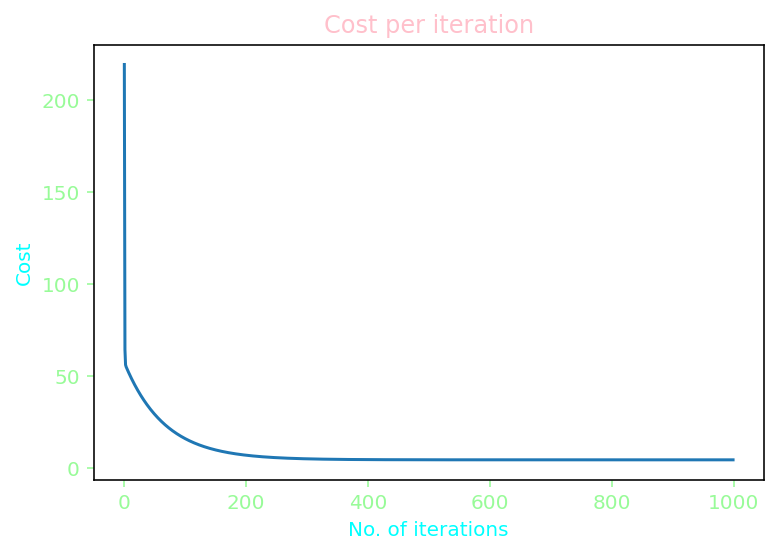

In [ ]:
plt.plot(cost_graph)
plt.xlabel('No. of iterations',color='cyan')
plt.ylabel('Cost',color='cyan')
plt.title('Cost per iteration',color='pink')
plt.tick_params(axis='x', colors='palegreen')
plt.tick_params(axis='y', colors='palegreen')
plt.show()

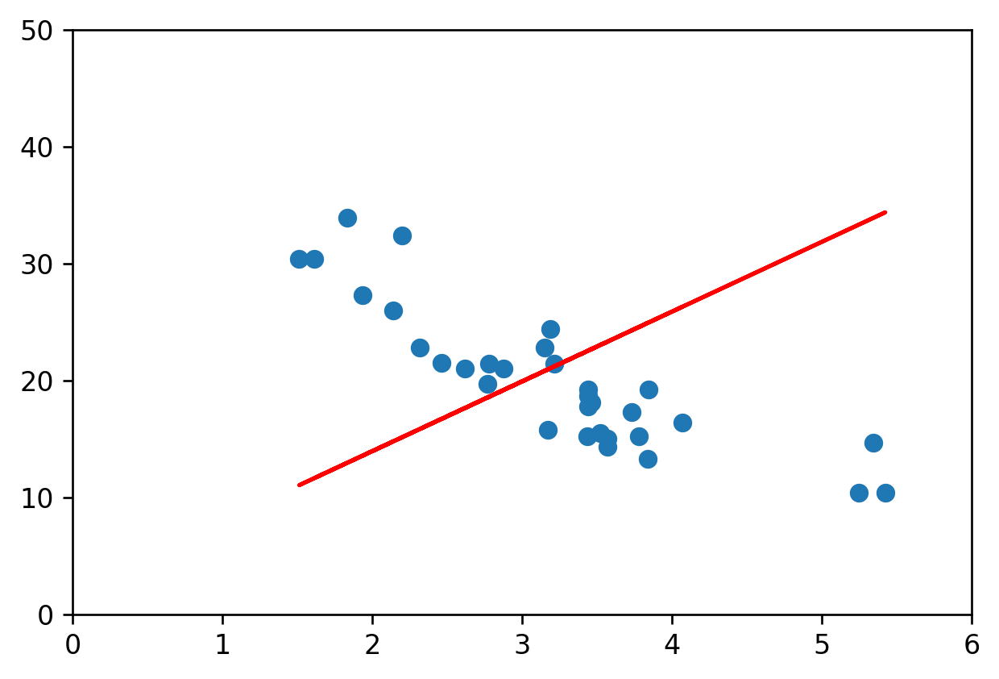

In [ ]:
import matplotlib.animation as animation
mpl.rcParams['animation.embed_limit'] = 2**128
mpl.rcParams['figure.dpi'] = 120
import numpy as np


fig = plt.figure()
ax = fig.add_subplot(111)
ax.set_xlim(0, 6)
ax.set_ylim(0, 50)
n = n_progress[0]
m = m_progress[0]
pred = m*X + n

line = ax.plot(X,pred, '-',c='r')[0]

def animate(i,n_prog,m_prog):
    pred = m_prog[i] * X + n_prog[i]
    line.set_data(X,pred)
    return line,

ani = animation.FuncAnimation(fig, animate, frames=len(n_progress), fargs=(n_progress,m_progress,))
ax.scatter(X,y)
ani.save('animation.gif', writer='pillow', fps=24)
HTML(ani.to_jshtml())

## <font color='cyan'>Multiple Linear Regression (Linear models with more features)</font>

An example of a linear model with two features is $\hat{y}_i = 1+3x_{i1}+5x_{i2}.$ 

In this example the value $1$ is referred to as the *intercept*.


If $p$ features in the data and we want to create a linear model, the *input-output* mechanism is 

$$
\underbrace{Y}_\text{Output}  = \underbrace{\beta_1X_1+\beta_2X_2+\beta_3X_3+...+\beta_pX_p}_\text{Linear combination of the features}
$$

In this model the features are $X_1, X_2, ...X_p$ and $\beta_1, \beta_2,...\beta_p$ are a set of weights (real numbers).


## <font color='cyan'>Linear vs Non-linear models</font>

This is a linear model in terms of the weights $\beta$: 


$$\large
\hat{y} = \beta_0 + \beta_1x_1 + \beta_2x_2 - \beta_3x_3
$$

An example for what linear in weights means
<font color='forestgreen'>
$$
\hat{y}(2\beta+3\alpha) = 2\hat{y}(\beta)+3\hat{y}(\alpha)
$$</font>

The following is a non-linear model in terms of the weights:


$$\large
\hat{y} = \beta_0 + \beta_1^3x_1 + \frac{1}{\beta_2+\beta_3}x_2 - e^{\beta_3}x_3
$$

<font color='magenta'>
$$
\hat{y}(2\beta+3\alpha) \neq 2\hat{y}(\beta)+3\hat{y}(\alpha)
$$</font>

The main point of linear regression is to assume that predictions can ben made by using a linear combination of the features. 

For example, if the data from each feature is $\begin{bmatrix}
           x_{11} \\
           x_{21} \\
           \vdots \\
           x_{n1}
         \end{bmatrix}$, $\begin{bmatrix}
           x_{12} \\
           x_{22} \\
           \vdots \\
           x_{n2}
         \end{bmatrix}$, $...
         \begin{bmatrix}
           x_{1p} \\
           x_{2p} \\
           \vdots \\
           x_{np}
         \end{bmatrix}$ then we assume that the depdendent variable is predicted by a linear combination of these columns populated with features' data. Each column represents a feature and each row an independent observation.

The predicted value is denoted by $\hat{y}$ and 


$$
\hat{y} = \beta_1\begin{bmatrix}
           x_{11} \\
           x_{21} \\
           \vdots \\
           x_{n1}
         \end{bmatrix}
         +
         \beta_2\begin{bmatrix}
           x_{11} \\
           x_{21} \\
           \vdots \\
           x_{n1}
         \end{bmatrix}
                  + ...
         \beta_p\begin{bmatrix}
           x_{1p} \\
           x_{2p} \\
           \vdots \\
           x_{np}
         \end{bmatrix}
$$

### We have a vector of weights:

$$
\beta = \begin{bmatrix}
           \beta_{1} \\
           \beta_{2} \\
           \vdots \\
           \beta_{p}
         \end{bmatrix}
$$

### <font color="green">
Critical thinking: what exactly is $\hat{y}$?
</font>

<font color='lightsalmon'> The matrix-vector product between the feaures and the weights
$$
\hat{y} = X\cdot\beta
$$
</font>

The main idea is that 

$$
\hat{y}= \begin{bmatrix}
           \hat{y}_{1} \\
            \hat{y}_{2}  \\
           \vdots \\
             \hat{y}_{n} 
         \end{bmatrix}
$$

represents the predictions we make by training (or as we say in ML *learning*) the weights $\beta.$

Training means running an optimization algorithm and determining the values of the weights that minimize an objective function.

### <font color='forestgreen'> We want to *learn* the weights $\beta_1,\beta_2,...\beta_p$ that minimize the sum of the squared residuals:

$$
\sum\limits_{i=1}^{n}\left(y_i-\sum\limits_{j=1}^{p}X_{i,j}\cdot\beta_j\right)^2
$$
</font>

### <font color='pink'> How do we know we are on the right track after we perform the minimization of the square residuals? <font>

###<font color='skyblue'>  We look at the distribution of the residuals and hope to see a bell shape (however if the number of observations is small this method is not very reliable): </font>

In [ ]:
              
from sklearn import linear_model
def residuals(data):
  x = data[:, 0].reshape(-1,1)
  y = data[:, 1].reshape(-1,1)
  lm = linear_model.LinearRegression()
  model = lm.fit(x,y)
  residuals = (y - model.predict(x))
  return residuals

In [ ]:
res = residuals(data)

In [ ]:
res

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


[Text(0, 0.5, 'Frequency'), Text(0.5, 0, 'Residuals')]

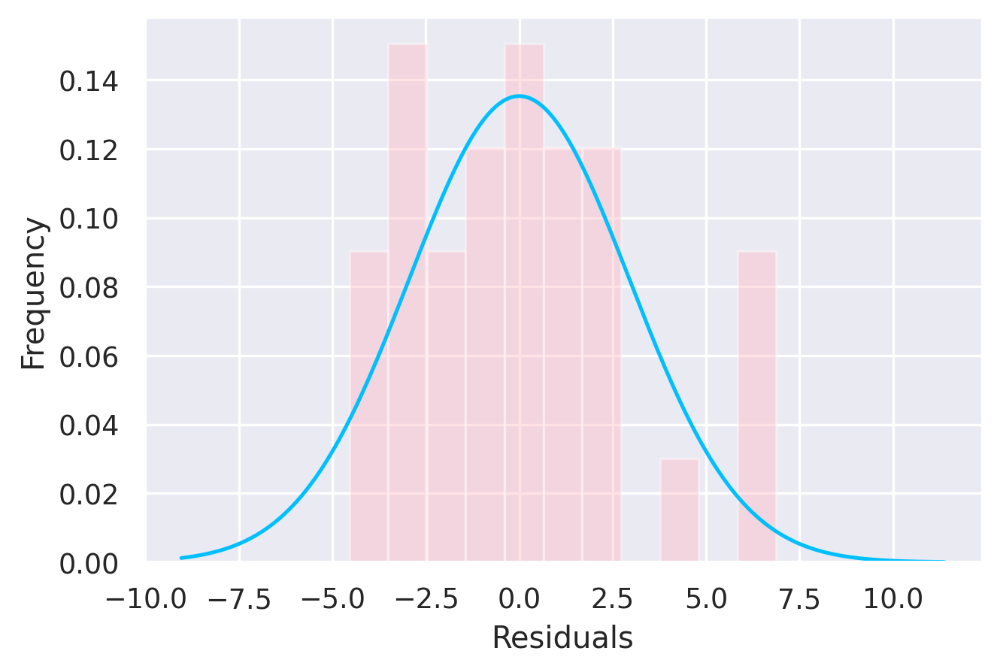

In [ ]:
import seaborn as sns
sns.set(color_codes=True)
 
# import uniform distribution
from scipy import stats
from scipy.stats import norm


# helping to display both the histogram and the underlying distribution
ax1 = sns.distplot(res,
                                        
                  bins=11,
                  kde=False,
                  color='deepskyblue',
                  hist_kws={"color":'lightpink'},
                  fit=stats.norm,
                  fit_kws={"color":'deepskyblue'})
ax1.set(xlabel='Residuals', ylabel='Frequency')

1. When can we see a normal histogram?
2. When is the multiple linear regression failing?
3. What is the solution to avoid failure - explore the concept of regularization.
4. How can we retrofit multiple linear regression for performing non-linear or polynomial regression?